<a href="https://colab.research.google.com/github/AiDAPT-A/AI_in_Architectural_Design_TUD/blob/main/tutorials/T6_From_Images_to_3D_Understanding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **From images to 3D understanding: Photogrammetry and data fusion**


## 📌 **Overview and learning objectives**
The essence of the field of computer vision is to make learn to make computers see the world as we see it. The first step towards this is being able to perceive depth from images and later build a 3d environment from images. We'll discover how AI can help in this pursuit and how it can be integrated in 3D representations.

### 🧠 **Learning objectives**
- Understanding opportunities of AI in computer vision and photogrammetry,
- Introducing the concept of data fusion when working with multiple modalities.

### 🐍 **New in Python**
- gradio: this library allows you to create very simple web UIs to demo machine learning models. We'll use it in this tutorial, namely to visualize 3d pointclouds
- trimesh: this library is normally used to work on 3d meshes, but we'll use it as a lightweight visualization tools for pointclouds.

---

**Overview**:

⚙️ [**Setup**](#t0)

📸 [**AI and Photogrammetry**](#t1)
- [**1.1 Classical photogrammetry**](#t1.1)
- [**1.2 Testing a new AI model**](#t1.2)
- [**1.3 Discussion**](#t1.3)

🔥 [**Data fusion**](#t2)
- [**2.1 3D results of your field trips**](#t2.1)
- [**2.2 A simple data fusion**](#t2.2)
- [**2.3 Fusing DINOv2 features in 3D**](#t2.3)

📊 [**Exercice**](#t3)


<a name="t0"></a>
## ⚙️ Setup

This notebook uses the GPU to run deep learning models more efficiently than on the CPU. Before running anything, make sure your Colab instance has a GPU:

<img src="https://gitlab.tudelft.nl/jvuillamy/mast3r/-/raw/teaching/resources/instruction.png" />

If for any reason you want to run the code in this tutorial only on the cpu, uncomment the second line below:

In [ ]:
DEVICE = 'cuda'
# DEVICE = 'cpu'

To avoid having too much code in this tutorial, the heavy-lifting for this tutorial is hidden inside the `tutorial_demos` package, that we download right now:

In [ ]:
%cd /content
!git clone --recursive https://gitlab.tudelft.nl/jvuillamy/mast3r.git -b teaching

%cd /content/mast3r
!git pull

!pip install -r requirements.txt
!pip install -r dust3r/requirements.txt
!pip install pycolmap trimesh

/content
Cloning into 'mast3r'...
remote: Enumerating objects: 355, done.
remote: Counting objects: 100% (50/50), done.
remote: Compressing objects: 100% (49/49), done.
remote: Total 355 (delta 18), reused 0 (delta 0), pack-reused 305 (from 1)
Receiving objects: 100% (355/355), 24.92 MiB | 8.00 MiB/s, done.
Resolving deltas: 100% (184/184), done.
Submodule 'dust3r' (https://github.com/naver/dust3r) registered for path 'dust3r'
Cloning into '/content/mast3r/dust3r'...
remote: Enumerating objects: 550, done.        
remote: Counting objects: 100% (405/405), done.        
remote: Compressing objects: 100% (208/208), done.        
remote: Total 550 (delta 293), reused 197 (delta 197), pack-reused 145 (from 1)        
Receiving objects: 100% (550/550), 732.88 KiB | 5.20 MiB/s, done.
Resolving deltas: 100% (319/319), done.
Submodule path 'dust3r': checked out '9869e71f9165aa53c53ec0979cea1122a569ade4'
Submodule 'croco' (https://github.com/naver/croco) registered for path 'dust3r/croco'
Cloni

In [ ]:
import tutorial_demos
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import torch

from torchvision import transforms as pth_transforms
from torchvision.transforms import InterpolationMode
import PIL
from PIL.ImageOps import exif_transpose


/content/mast3r/dust3r/dust3r/cloud_opt/base_opt.py:275: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @torch.cuda.amp.autocast(enabled=False)


<a name="t1"></a>
## 📸 AI and Photogrammetry


<a name="t1.1"></a>
### 1.1 Classical Photogrammetry

Understanding the 3D world using images is one of the oldest problem in Computer Vision.

Traditionally, this is done in the following steps:
- **keypoint extraction**: finding specific locations in the image that can be easily identified in other views
- **keypoint matching**: find the correspondence between keypoints in pairs of images.

Here is an example of such a matching, where the green line correspond to correct matches, and the red lines are erroneous matches:

<center>
<img height="500px" src="https://cs.brown.edu/courses/csci1430/2021_Spring/proj2_featurematching/example.jpg" />

<em>Image from https://cs.brown.edu/courses/csci1430/2021_Spring/proj2_featurematching/</em>
</center>


Many methods have been proposed to programmatically find and match keypoints in images, but the acquisition diversity (lighting changes, image overlap, scale changes) can make this process error-prone:
<center>
<img src="https://gitlab.tudelft.nl/jvuillamy/mast3r/-/raw/teaching/resources/different_conditions.png" />
<em>Different lighting conditions or very large difference of viewpoint can fail traditional methods.<em>
</center>

<a name="t1.2"></a>
### 1.2 Testing a new AI model

Today's goal is to explore and understand how new AI models can help to reinvent this classic problem. We will be studying one very recent model associated to the paper:

<center>
<img src="https://github.com/naver/dust3r/blob/main/assets/pipeline1.jpg?raw=true" />
<p>
<em>DUSt3R: Geometric 3D Vision Made Easy</em>, Wang et al., CVPR 2024
</center>


**How is this model different from classical photogrammetry?**

The model takes as input a pair of images and outputs 3D points for each image in a common referential. It differentiates itself from classical photogrammetry as it doesn't explicitly define keypoints and matches these keypoints between the images: the neural network is allowed to freely organize itself. Using large datasets of images pairs with corresponding 3d pointclouds, the model is trained to output the correct pointclouds for the given image pairs.   
<center>
<img src="https://gitlab.tudelft.nl/jvuillamy/mast3r/-/raw/teaching/resources/dust3r_explained.png" />
</center>

Let's give it a try! We start by creating and downloading the pretrained model.

In [ ]:
from mast3r.model import AsymmetricMASt3R

# We load the model.
dust3r = AsymmetricMASt3R.from_pretrained("naver/MASt3R_ViTLarge_BaseDecoder_512_catmlpdpt_metric")
dust3r = dust3r.to(DEVICE)
dust3r.eval();

Warning, cannot find cuda-compiled version of RoPE2D, using a slow pytorch version instead


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/546 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.75G [00:00<?, ?B/s]

In [ ]:
tutorial_demos.test_mast3r_model(dust3r, device=DEVICE, show_details=False)

Outputing stuff in /tmp/tmp149gkpo6dust3r_gradio_demo
Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://2980b88161760a56ff.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


<a name="t1.3"></a>
### 1.3 Discussion
Run the examples in the demo above as well as your own examples, and identify:
1. What knowledge can the AI models learn?
2. In what scenario can it outperform traditional photogrammetry pipeline?
3. What are potential weaknesses of this model?

<a name="t2"></a>
## 🔥 Data fusion


<a name="t2.1"></a>
### 2.1 3D results of your field trips


To create 3D representations from the images taken during your field trips, the [open-source photogrammetry software COLMAP](https://colmap.github.io/) was used.

<center>
<img src="https://colmap.github.io/_images/sparse.png" />

<em>Structure-from-Motion Revisited</em>, Schönberger et al., CVPR 2016
</center>

You can find your projects in the [following drive](https://drive.google.com/drive/folders/1kVuP7Hk4_v762uJ-oL88nhKi4hu4btel?usp=sharing).

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


The COLMAP software also comes with a Python library, which makes importing a COLMAP project in Python extremely simple:

In [ ]:
from pycolmap import Reconstruction

recon = Reconstruction('/content/drive/MyDrive/Education/group2/sparse')
print(recon.summary())

Reconstruction:
	num_cameras = 2
	num_images = 64
	num_reg_images = 64
	num_points3D = 48603
	num_observations = 165043
	mean_track_length = 3.39574
	mean_observations_per_image = 2578.8
	mean_reprojection_error = 1.18162


In [ ]:
recon.import_PLY('/content/drive/MyDrive/Education/group2/fused.ply')

tutorial_demos.show_reconstruction(recon)

Running Gradio in a Colab notebook requires sharing enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://cbc977dba49c69da75.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


<a name="t2.2"></a>
### 2.2 A simple data fusion: depthmaps and colors

The term *data fusion* is used to define the process of combining multiple data modalities into a coherent common representation. In our case, we will be combining data from images and 3d information from depth maps.  

In [ ]:
IMAGE_PATH='/content/drive/MyDrive/Education/group2/images/'
DEPTH_PATH='/content/drive/MyDrive/Education/group2/stereo/depth_maps/'

(np.float64(-0.5), np.float64(1349.5), np.float64(2399.5), np.float64(-0.5))

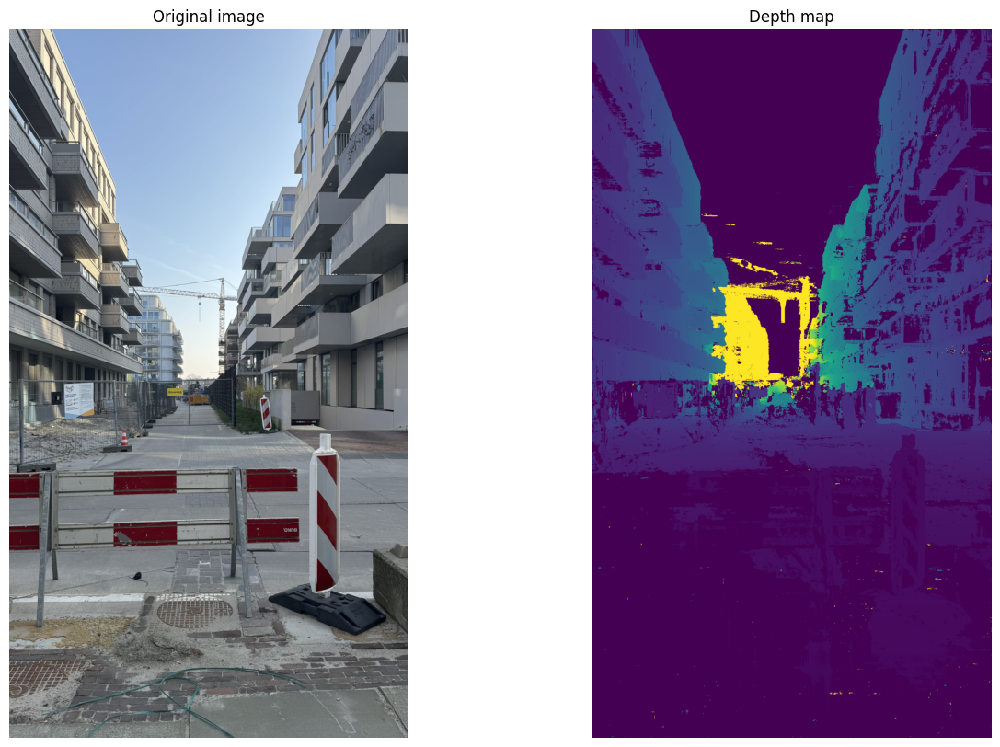

In [ ]:
img_name = '3_facade_normal/IMG_3404.png'

img = plt.imread(os.path.join(IMAGE_PATH, img_name))
depth_map = tutorial_demos.read_depthmap(os.path.join(DEPTH_PATH, f'{img_name}.geometric.bin'))

min_depth, max_depth = np.percentile(depth_map, [0, 98])

viewed_depth = depth_map
viewed_depth[depth_map < min_depth] = min_depth
viewed_depth[depth_map > max_depth] = max_depth

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))

ax1.set_title("Original image")
ax1.imshow(img)
ax1.axis('off')

ax2.set_title("Depth map")
ax2.imshow(viewed_depth)
ax2.axis('off')

In [ ]:
import trimesh

def create_pointcloud_from_depthmap(recon, image_name, img, depth_map, min_depth=0, max_depth=1_000):
  # Create 3d points from the depth map and associate the color of the original image.
  points3d = []
  colors = []

  image = recon.find_image_with_name(img_name)
  camera = np.linalg.inv(recon.cameras[image.camera_id].calibration_matrix())

  for x in range(depth_map.shape[0]):
      for y in range(depth_map.shape[1]):
          if depth_map[x, y] > min_depth and depth_map[x, y] < max_depth:
            points3d.append(camera @ np.array([ depth_map[x, y] * y,
                                                depth_map[x, y] * x,
                                                depth_map[x, y] ]))
            colors.append(img[x, y])

  point_cloud = trimesh.points.PointCloud(np.array(points3d), colors=colors)
  print(point_cloud)

  # Create a scene and add the point cloud
  scene = trimesh.Scene()
  scene.add_geometry(point_cloud)
  return scene

pts3d = create_pointcloud_from_depthmap(recon, img_name, img, depth_map, min_depth, max_depth)
pts3d.show('notebook')

<trimesh.PointCloud(vertices.shape=(1427804, 3))>


This is our first example of **data fusion**: we've successfully combined 3d information from the depthmaps with the color information of the image! But this means many types of information can be brought into 3d. Once we have this correspondence between images and the 3d space, we can for free use all the AI model on images and bring them to 3D! This is very interesting because AI models are extremely performant on the image domain, and are not (yet) as production-ready when working on pointclouds, graphs or meshes.

Here are a few approaches that use exactly this principle:
- [DreamFusion, Pool et al.](https://dreamfusion3d.github.io/)
This paper uses a generative model to create images from a text prompt and then merges these predicted iamges into a 3d model, effectively creating a text-to-3d method.

- [SAM3D: Segment Anything in 3D Scenes, Yang et al.](https://arxiv.org/abs/2306.03908)
Using the Segment Anything Model (SAM), the predicted segmentation are projected in 3D and used to segment pointclouds.

<a name="t2.3"></a>
### 2.3 Using DINOv2 for 3D segmentation

In what follows, we will use the **DINOv2 model** to analyze our images and transfer this analysis in 3D.

However, our descriptors will not be at the *image*-level as in previous tutorials -- *image descriptor* in blue, but at the *patch*-level
<center>
<img src="https://gitlab.tudelft.nl/jvuillamy/mast3r/-/raw/teaching/resources/dinov2.png" />
</center>

This means the descriptors will represent a small 14x14 patch of the image, and allow to decscribe more finely the content of the images.

In [ ]:
# We load the model dinov2
dino_model = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14_reg').to(DEVICE)
PATCH_SIZE = 14

# We describe the transform of our images:
# - Resize: this is needed to make sure it fits on the GPU memory
# - Normalize: this ensures the images are similar to the training data of the model (similar 'mean' and 'variance' in colors).
DINO_TRANSFORM = pth_transforms.Compose([
    pth_transforms.ToTensor(),
    pth_transforms.Resize(size=720, max_size=2048),
    pth_transforms.Normalize(
        (0.485, 0.456, 0.406), (0.229, 0.224, 0.225)
    ),
])

Downloading: "https://github.com/facebookresearch/dinov2/zipball/main" to /root/.cache/torch/hub/main.zip
/root/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xFormers is not available (SwiGLU)")
/root/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/attention.py:33: UserWarning: xFormers is not available (Attention)
  warnings.warn("xFormers is not available (Attention)")
/root/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/block.py:40: UserWarning: xFormers is not available (Block)
  warnings.warn("xFormers is not available (Block)")
Downloading: "https://dl.fbaipublicfiles.com/dinov2/dinov2_vits14/dinov2_vits14_reg4_pretrain.pth" to /root/.cache/torch/hub/checkpoints/dinov2_vits14_reg4_pretrain.pth
100%|██████████| 84.2M/84.2M [00:00<00:00, 174MB/s]


In [ ]:
from tqdm import tqdm

features = []

image_names = [
    '3_facade_normal/IMG_3404.png',
    '3_facade_normal/IMG_3403.png',
    '3_facade_normal/IMG_3402.png',
    '3_facade_normal/IMG_3401.png',
    '3_facade_normal/IMG_3400.png',
    '3_facade_normal/IMG_3399.png',
    '3_facade_normal/IMG_3398.png',
]

for image in tqdm(image_names, desc='Computing dino features'):
    img = exif_transpose(PIL.Image.open(os.path.join(IMAGE_PATH, image))).convert('RGB')
    img = DINO_TRANSFORM(img)

    # The image is cropped so that its size is a multiple of the PATCH_SIZE.
    original_shape = img.shape[1:]
    h, w = (img.shape[1] - img.shape[1] % PATCH_SIZE,
            img.shape[2] - img.shape[2] % PATCH_SIZE)
    img = pth_transforms.CenterCrop((h, w))(img).unsqueeze(0)

    # We run the model on our image and extract the `patch tokens`.
    feats = dino_model.forward_features(img.to(DEVICE))
    feats = feats['x_norm_patchtokens'].squeeze().cpu().detach()

    # The descriptors are reorganized to have the shape of an image.
    feats = feats.reshape((h // PATCH_SIZE, w // PATCH_SIZE, -1))

    features.append(feats)

features = torch.stack(features)

# We normalize the features so that can be compared between each other.
features = features / features.norm(dim=-1, keepdim=True)

print(features.shape)

Computing dino features: 100%|██████████| 7/7 [00:05<00:00,  1.20it/s]

torch.Size([7, 91, 51, 384])


Let's use these descriptors as a selection tool in our images.
Here is the process we wil follow:
<center>
<img src="https://gitlab.tudelft.nl/jvuillamy/mast3r/-/raw/teaching/resources/pick_process.png" />
</center>

In a reference image, we will pick coordinates that correspond to the region we want to select (**Step 1**). These coordinates are associated to a specific patch of our image and their corresponding patch features (the patch is shown in green on the image). We can now search for similar descriptors in a second image (**Step 2**). Similar patches should correspond to the same region in the second image (**Step 3**).
<a name="cell19"></a>

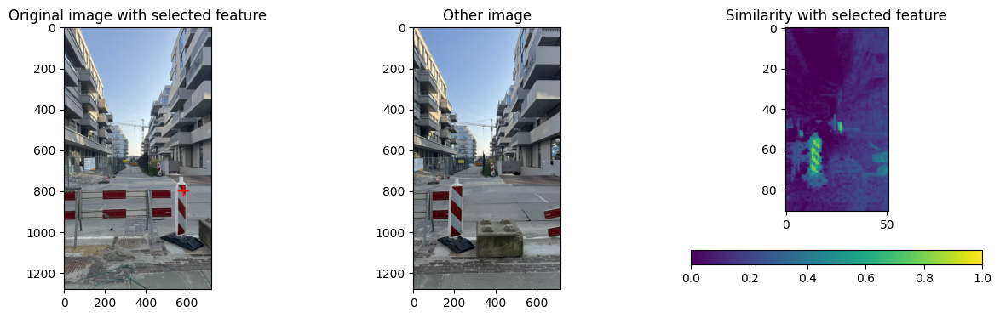

In [ ]:
# Image picker
pick_image_idx = 0
coords = (800, 580)

selected_feature = features[pick_image_idx][coords[0] // PATCH_SIZE, coords[1] // PATCH_SIZE]

other_image_idx = 1
similarity = torch.matmul(features[other_image_idx], selected_feature)

# Visualize similiarities
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4))

img = exif_transpose(PIL.Image.open(os.path.join(IMAGE_PATH, image_names[pick_image_idx]))).convert('RGB')
img = pth_transforms.Resize(size=720, max_size=2048)(img)
img = cv2.drawMarker(np.array(img), (coords[1], coords[0]), color=(255, 0, 0),
                     markerSize=50, thickness=5)

ax1.set_title("Original image with selected feature")
ax1.imshow(img)

ax2.set_title("Other image")
other_img = exif_transpose(PIL.Image.open(os.path.join(IMAGE_PATH, image_names[other_image_idx]))).convert('RGB')
other_img = pth_transforms.Resize(size=720, max_size=2048)(other_img)
ax2.imshow(other_img)

ax3.set_title("Similarity with selected feature")
simliarity_s = ax3.imshow(similarity, vmin=0, vmax=1)
fig.colorbar(simliarity_s, orientation='horizontal')


This similarity can be used in different views and are the first step towards selecting the object in 3D.

<a name="different-views" />

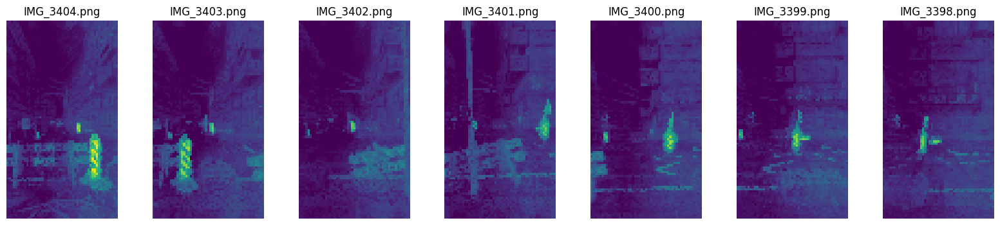

In [ ]:
fig, axis = plt.subplots(1, len(image_names), figsize=(20, 4))
for index, (image_name, ax) in enumerate(zip(image_names, axis)):
  other_image_name = image_names[other_image_idx]
  similarity = torch.matmul(features[index], selected_feature)
  ax.imshow(similarity, vmin=0, vmax=1)
  ax.axis('off')
  ax.set_title(image_name.split('/')[1])

Each of these similarities can then be used to select objects in the image, and using the camera positions, select the object in 3D.

<a name="t3"></a>
## 📊 **Exercise**

Use the model from your field trip (or the one from another group) and use the DINOv2 model to segment **two different objects** in the scene (facade element, car, bike lane, green spaces...). *You might have to duplicate the 2 last cells to present the two different results.*

For each object,
  - Pick a location in a reference image, and show that the descriptor similarity can be used to isolate the object in one other image as in
  [**this cell**](#cell19) (2 x 2pt)
  - Compute the similarities on at least 3 different images similar to [**this cell**](#different-views) (2 x 2pt)

Explain two limitations of using the image-based selection method presented in this tutorial compared to a selection method directly based on the 3d model. (2pt)